## Additional maps
A workspace that I use for creating maps beyond those in the tutorial (such as maps of specific travels). See media_geotag_mapper_tutorial_vX.ipynb (where x refers to the latest version of the code) for more documentation on these steps.

In [1]:
import time
start_time = time.time() # Allows the program's runtime to be measured
import os
import pandas as pd
import datetime
import matplotlib.pyplot as plt
import IPython.display
from IPython.display import display

from media_geotag_functions_v2 import generate_media_list, \
    retrieve_pic_locations, retrieve_clip_locations, generate_loc_list, \
    map_media_locations, folder_list_to_map, flip_lon, create_map_screenshot, \
    calculate_distance_by_year, convert_png_to_smaller_jpg, \
    batch_create_map_screenshots, batch_convert_pngs_to_smaller_jpgs

In [2]:
folder_name = 'extra_files\spain_trip' 
file_name = 'spain_trip'

top_folder_list = [
r'H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Galaxy S21 Ultra\Vol 8']

In [3]:
generate_new_lists = True
if generate_new_lists == True:
    df_media = generate_media_list(top_folder_list=top_folder_list,
    folder_name = folder_name)
    df_all_locations = generate_loc_list(df_media = df_media, 
    folder_name = folder_name)

Retrieving picture locations:


0it [00:00, ?it/s]


Retrieving clip locations:


100%|██████████| 1374/1374 [01:49<00:00, 12.58it/s]


In [4]:
df_media = pd.read_csv(f'{folder_name}_media_list.csv')
df_media.head(5)

,path,name,ctime,modified_time,accessed_time,megabytes,extension,type
0,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220525_121748.mp4,2022-06-06 12:12:02,2022-05-25 12:17:59,2023-09-16 19:00:16,104.724891,mp4,clip
1,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220525_131017.mp4,2022-06-06 12:12:02,2022-05-25 13:10:30,2023-09-16 19:00:14,116.117058,mp4,clip
2,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220525_185920.mp4,2022-06-06 12:12:03,2022-05-25 18:59:43,2023-09-16 19:00:56,222.656303,mp4,clip
3,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220527_203312.mp4,2022-06-06 12:12:05,2022-05-27 20:33:19,2023-09-16 19:00:10,63.177477,mp4,clip
4,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220528_083026.mp4,2022-06-06 12:12:05,2022-05-28 08:30:35,2023-09-16 19:00:10,80.877939,mp4,clip


In [5]:
df_all_locations = pd.read_csv(f'{folder_name}_media_locations.csv')

In [6]:
df_all_locations

,path,name,ctime,modified_time,accessed_time,megabytes,extension,type,raw_location,lat,lon,alt_capture_time
0,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220525_121748.mp4,2022-06-06 12:12:02,2022-05-25 12:17:59,2023-09-16 19:00:16,104.724891,mp4,clip,+40.8071-073.9656/,40.8071,-73.9656,x
1,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220525_131017.mp4,2022-06-06 12:12:02,2022-05-25 13:10:30,2023-09-16 19:00:14,116.117058,mp4,clip,+40.8070-073.9658/,40.8070,-73.9658,x
2,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220525_185920.mp4,2022-06-06 12:12:03,2022-05-25 18:59:43,2023-09-16 19:00:56,222.656303,mp4,clip,+40.8071-073.9657/,40.8071,-73.9657,x
3,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220527_203312.mp4,2022-06-06 12:12:05,2022-05-27 20:33:19,2023-09-16 19:00:10,63.177477,mp4,clip,+00.0000+000.0000/,0.0000,0.0000,x
4,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220528_083026.mp4,2022-06-06 12:12:05,2022-05-28 08:30:35,2023-09-16 19:00:10,80.877939,mp4,clip,+40.8071-073.9656/,40.8071,-73.9656,x
...,...,...,...,...,...,...,...,...,...,...,...,...
1369,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220621_183715.mp4,2022-06-23 22:16:16,2022-06-21 20:37:43,2022-08-05 22:19:53,267.245642,mp4,clip,+35.8967-106.0208/,35.8967,-106.0208,x
1370,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220621_191947.mp4,2022-06-23 22:16:19,2022-06-21 21:20:09,2022-08-05 22:19:55,205.763351,mp4,clip,+35.7474-106.0188/,35.7474,-106.0188,x
1371,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220622_070522.mp4,2022-06-23 22:16:22,2022-06-22 09:05:29,2022-08-05 22:19:55,54.360118,mp4,clip,+35.6725-105.9576/,35.6725,-105.9576,x
1372,H:\D2V1\Vids Clips Pics\2 Unsorted Clips\34 Ga...,20220622_071918.mp4,2022-06-23 22:16:23,2022-06-22 09:19:26,2022-08-05 22:19:56,64.887058,mp4,clip,+35.6725-105.9577/,35.6725,-105.9577,x


In [7]:
absolute_path_to_map_folder = \
r'C:\Users\kburc\D1V1\Documents\!Dell64docs\Programming\py\kjb3_programs\media_geotag_mapper\extra_maps'
screenshot_save_path = 'extra_map_screenshots'

In [8]:
map = map_media_locations(df_all_locations, folder_path = 'extra_maps', tiles = 'Stamen Terrain',
file_name = file_name, starting_location = [39.17, -106.87], zoom_start = 14, add_paths = True)
map

Added 1113 markers to the map.


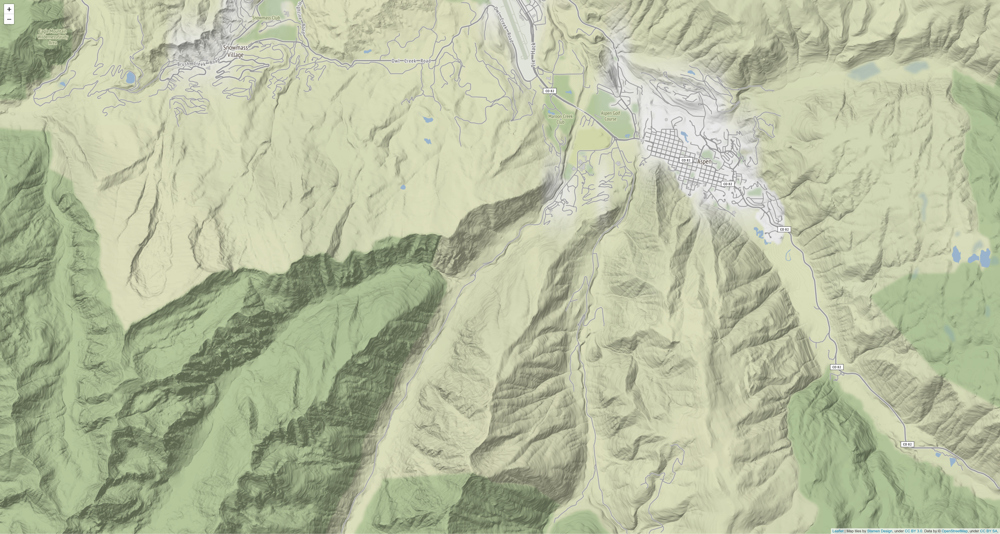

In [9]:
create_map_screenshot(absolute_path_to_map_folder = 
absolute_path_to_map_folder, map_name= file_name+'_locations.html', 
screenshot_save_path = screenshot_save_path)

IPython.display.display(IPython.display.Image(
    filename=screenshot_save_path+'\\'+file_name+'_locations.png'))
# This code is based on DrMcCleod's response at:
# https://stackoverflow.com/a/35061341/13097194